In [2]:
import re

def extract_string_between_quotes(string):
    pattern = r'"([^"]*)"'
    match = re.search(pattern, string)
    if match:
        return match.group(1)
    else:
        return None

def extract_key(string):
    li = string.strip().split()
    if len(li)>1:
        x=li[1].replace("(","")
        x=x.replace(")","")
        return x
    return string.strip().split()[0]
    
def extract_largest_number(string):
    numbers = re.findall(r'-?\d+(?:\.\d+)?', string)
    if numbers:
        largest_number = max(map(float, numbers))
        return largest_number
    else:
        return None
    
class Pin:
    def __init__(self,pg,rv,fv,pin=" "):
        self.pin=pin
        self.pg=pg
        self.rv=rv
        self.fv=fv
cell = {}

def process_file(filename):
    powerdict = {}
    with open(filename, "r") as f:
        with open("cellmap.txt", "w") as w:
            line = f.readline()
            while line:
                if line.find("cell (") >= 0 or line.find("internal_power") >= 0 or line.find(
                        "related_pin") >= 0 or line.find("related_pg_pin") >= 0:
                    w.writelines(line)
                else:
                    if line.find("rise_power (") >= 0:
                        maxnum = -1000
                        while line.find("}") < 0:
                            if line.find("\\") >= 0 and line.find("values") < 0:
                                maxnum = extract_largest_number(line)
                            line = f.readline()
                        w.writelines("max risevalue: " + str(maxnum) + "\n")
                    elif line.find("fall_power (") >= 0:
                        while line.find("}") < 0:
                            if line.find("\\") >= 0 and line.find("values") < 0:
                                maxnum = extract_largest_number(line)
                            line = f.readline()
                        w.writelines("max fallvalue: " + str(maxnum) + "\n}\n")
                line = f.readline()
        w.close()
    li = []
    with open("cellmap.txt", "r") as f:
        with open("cellmap2.txt", "w") as w:
            line = " "
            while line:
                line = f.readline()
                if line.find("cell (") >= 0:
                    li.append(extract_key(line))
                    w.writelines(line)
                    while line.find("internal_power") < 0:
                        line = f.readline()
                w.writelines(line)
        w.close()
    with open("cellmap2.txt", "r") as f:
        line = "xx"
        key = ""
        while line:
            if line.find("cell (") >= 0:
                key = extract_key(line)
                powerlist = []
                line = f.readline()
                while line.find("cell (") < 0 and line:
                    if line.find("internal_power") >= 0:
                        pin = " "
                        rv = 0
                        fv = 0
                        pg = ""
                        while line.find("}") < 0 and line:
                            line = f.readline()
                            if line.find("related_pin") >= 0:
                                pin = extract_string_between_quotes(line)
                            if line.find("VDD") >= 0:
                                pg = "VDD"
                            if line.find("VSS") >= 0:
                                pg = "VSS"
                            if line.find("risevalue") >= 0:
                                rv = float(line.strip().split()[-1])
                            if line.find("fallvalue") >= 0:
                                fv = float(line.strip().split()[-1])
                        powerlist.append(Pin(pg, rv, fv, pin))
                    line = f.readline()
                powerdict[key] = powerlist
            else:
                line = f.readline()
    return powerdict
 

In [3]:
#asap7sc7p5t_AO_LVT_TT_nldm_211120.lib
#asap7sc7p5t_OA_LVT_TT_nldm_211120 (1).lib
#asap7sc7p5t_SIMPLE_LVT_TT_nldm_211120.lib
#asap7sc7p5t_SEQ_LVT_TT_nldm_220123.lib
#asap7sc7p5t_INVBUF_SLVT_TT_nldm_220122.lib
filelist = ["asap7sc7p5t_AO_LVT_TT_nldm_211120.lib","asap7sc7p5t_OA_LVT_TT_nldm_211120 (1).lib","asap7sc7p5t_SIMPLE_LVT_TT_nldm_211120.lib","asap7sc7p5t_SEQ_LVT_TT_nldm_220123.lib","asap7sc7p5t_INVBUF_SLVT_TT_nldm_220122.lib"]
powerdict={}
for filename in filelist:
    powerdict.update(process_file(filename))
print(len(powerdict))

200


In [4]:
ogdict={}
for x in powerdict:
    maxnum=-1000
    for y in powerdict[x]:
        if y.pg == "VDD":
            maxnum=max(y.rv,y.fv,maxnum)
    ogdict[x]=maxnum
print(ogdict)

{'A2O1A1Ixp33_ASAP7_75t_L': 0.581277, 'A2O1A1O1Ixp25_ASAP7_75t_L': 0.592485, 'AO211x2_ASAP7_75t_L': 8.36883, 'AO21x1_ASAP7_75t_L': 9.22268, 'AO21x2_ASAP7_75t_L': 9.99859, 'AO221x1_ASAP7_75t_L': 9.85999, 'AO221x2_ASAP7_75t_L': 4.08372, 'AO222x2_ASAP7_75t_L': 9.65929, 'AO22x1_ASAP7_75t_L': 7.2047, 'AO22x2_ASAP7_75t_L': 9.87526, 'AO31x2_ASAP7_75t_L': 1.38882, 'AO322x2_ASAP7_75t_L': 7.08272, 'AO32x1_ASAP7_75t_L': 8.66357, 'AO32x2_ASAP7_75t_L': 0.860348, 'AO331x1_ASAP7_75t_L': 7.84338, 'AO331x2_ASAP7_75t_L': 9.9008, 'AO332x1_ASAP7_75t_L': 9.00021, 'AO332x2_ASAP7_75t_L': 9.64647, 'AO333x1_ASAP7_75t_L': 9.63114, 'AO333x2_ASAP7_75t_L': 9.85823, 'AO33x2_ASAP7_75t_L': 9.0006, 'AOI211x1_ASAP7_75t_L': 9.19637, 'AOI211xp5_ASAP7_75t_L': 9.96591, 'AOI21x1_ASAP7_75t_L': 1.08141, 'AOI21xp33_ASAP7_75t_L': 0.357738, 'AOI21xp5_ASAP7_75t_L': 0.531479, 'AOI221x1_ASAP7_75t_L': 0.852338, 'AOI221xp5_ASAP7_75t_L': 9.84841, 'AOI222xp33_ASAP7_75t_L': 8.90051, 'AOI22x1_ASAP7_75t_L': 1.16354, 'AOI22xp33_ASAP7_75t_L

In [5]:
import random as rnd
import numpy as np
from matplotlib import pyplot as plt

def f(x, p,li):
    c = rnd.uniform(0, 1)
    r2 = rnd.uniform(c, 1)
    r1 = rnd.uniform(0, c)

    while (r2 - c) < (c - r1):
        c = rnd.uniform(0, 1)
        r2 = rnd.uniform(c, 1)
        r1 = rnd.uniform(0, c)  
    m1=p/(c-r1)
    m2=p/(c-r2)
    li.append(r2-c)
    li.append(c-r1)


distancedict={}
x=np.linspace(0,1,10000)
for y in ogdict:
    distli=[]
    f(x, ogdict[y],distli)
    distancedict[y]=distli

    

In [6]:
print(distancedict)

{'A2O1A1Ixp33_ASAP7_75t_L': [0.601685810396625, 0.3326854769679111], 'A2O1A1O1Ixp25_ASAP7_75t_L': [0.6787615858193375, 0.19996351555801262], 'AO211x2_ASAP7_75t_L': [0.5161874407140377, 0.000781169669619941], 'AO21x1_ASAP7_75t_L': [0.40523308648964373, 0.2058033028254476], 'AO21x2_ASAP7_75t_L': [0.13363785123182292, 0.023316876924852292], 'AO221x1_ASAP7_75t_L': [0.32945552428144675, 0.03117704452450816], 'AO221x2_ASAP7_75t_L': [0.6730452028263394, 0.19718709679978386], 'AO222x2_ASAP7_75t_L': [0.32766730206557615, 0.006255402504646096], 'AO22x1_ASAP7_75t_L': [0.026855107250934873, 0.011765425608109559], 'AO22x2_ASAP7_75t_L': [0.23391854991541838, 0.18681645184680873], 'AO31x2_ASAP7_75t_L': [0.08534132907684566, 0.07485471150910072], 'AO322x2_ASAP7_75t_L': [0.9096424069936893, 0.017360118962289568], 'AO32x1_ASAP7_75t_L': [0.4697808259914459, 0.20783409381932688], 'AO32x2_ASAP7_75t_L': [0.53814498629715, 0.022607187625546143], 'AO331x1_ASAP7_75t_L': [0.696447625663442, 0.20955939040643734]

In [7]:
import pickle
from delayobject import DelayObject

# Load the objectdict dictionary from parsingfile.ipynb
with open('objectdict.pickle', 'rb') as f:
    objectdict = pickle.load(f)

In [8]:
print(objectdict["!"])

In [9]:
print(len(objectdict))

39137


In [10]:
class OutputPair:
    def __init__(self,cellname,output):
        self.cellname=cellname
        self.output=output


with open('outputlist.pickle', 'rb') as f:
    outputlist=pickle.load(f)


In [11]:
print(len(outputlist))

50552


In [12]:
namelist=[]
for y in list(objectdict.keys()):
    namelist.append(objectdict[y].name)
    
print(namelist)

['fbus_ICCADs_fixedClockNode_auto_out_clock', 'reset', 'mmio_axi4_0_aw_ready', 'mmio_axi4_0_w_ready', 'mmio_axi4_0_b_valid', 'mmio_axi4_0_b_bits_id', 'mmio_axi4_0_b_bits_resp', 'mmio_axi4_0_ar_ready', 'mmio_axi4_0_r_valid', 'mmio_axi4_0_r_bits_id', 'mmio_axi4_0_r_bits_data', 'mmio_axi4_0_r_bits_resp', 'mmio_axi4_0_r_bits_last', 'fbus_ICCADs_coupler_from_port_named_slave_port_axi4_ICCADs_axi4index_auto_out_aw_valid', 'l2_frontend_bus_axi4_0_aw_bits_id', 'fbus_ICCADs_coupler_from_port_named_slave_port_axi4_ICCADs_axi4index_auto_out_aw_bits_addr', 'fbus_ICCADs_coupler_from_port_named_slave_port_axi4_ICCADs_axi4index_auto_out_aw_bits_len', 'fbus_ICCADs_coupler_from_port_named_slave_port_axi4_ICCADs_axi4index_auto_out_aw_bits_size', 'fbus_ICCADs_coupler_from_port_named_slave_port_axi4_ICCADs_axi4index_auto_out_aw_bits_burst', 'l2_frontend_bus_axi4_0_aw_bits_lock', 'l2_frontend_bus_axi4_0_aw_bits_cache', 'l2_frontend_bus_axi4_0_aw_bits_prot', 'l2_frontend_bus_axi4_0_aw_bits_qos', 'fbus_ICCAD

In [13]:
for x in outputlist:
    if x.output == objectdict["ZK$"].name:
        print(ogdict[x.cellname])
newdict= {float(key) * 1e-8: value for key, value in objectdict["ZK$"].toggle.items()}
print(newdict)

9.84841
{0.9: '0', 0.90005031: '1', 0.90005172: '0', 0.90015022: '1', 0.90015155: '0', 0.90015239: '1', 0.90015246: '0', 0.90015269: '1', 0.90015271: '0', 0.90015294: '1', 0.90015302: '0', 0.90025298: '1', 0.90035016: '0', 0.90045187: '1', 0.9004519: '0', 0.9004523400000001: '1', 0.90045235: '0', 0.90045254: '1', 0.90045277: '0', 0.90045295: '1', 0.90055026: '0', 0.9005516100000001: '1', 0.9005520300000001: '0', 0.9006516800000001: '1', 0.90075132: '0', 0.9007516600000001: '1', 0.90075174: '0', 0.90085149: '1', 0.9008517300000001: '0', 0.90085232: '1', 0.90085241: '0', 0.90085299: '1', 0.9008532100000001: '0', 0.90085369: '1', 0.90085381: '0', 0.90095155: '1', 0.90095167: '0', 0.90105159: '1', 0.90105168: '0', 0.90105247: '1', 0.90105285: '0', 0.90125151: '1', 0.90125161: '0', 0.90125168: '1', 0.90125186: '0', 0.90125214: '1', 0.90125223: '0', 0.9012522900000001: '1', 0.90125232: '0', 0.9012526200000001: '1', 0.90125269: '0', 0.90135211: '1', 0.90135214: '0', 0.90135257: '1', 0.9013525

In [14]:
import matplotlib.pyplot as plt
import numpy as np

y = []
peak = ogdict["XNOR2xp5_ASAP7_75t_L"]
t1 = distancedict["XNOR2xp5_ASAP7_75t_L"][1]
t2 = distancedict["XNOR2xp5_ASAP7_75t_L"][0]

def g(value, peak, t1, t2, t):
    c = value + t1
    r2 = c + t2
    r1 = value
    m1 = peak / (c - r1)
    m2 = peak / (c - r2)
    
    if t <= c:
        return m1 * (t - r1)
    return m2 * (t - r2)


timepowerdict = {}


newdict_keys = list(newdict.keys())

powerx=[]
for x in newdict_keys:
    powerx.append(x)
    powerx.append(x+t1+t2)

additional_points = np.linspace(1, 2, 1000)
powerx = powerx + additional_points.tolist()  # Convert additional_points to a list before adding
powerx.sort()

for value in newdict_keys:
    if newdict[value] == "1":
        for t in powerx:
            power = g(value, peak, t1, t2, t)
            if power >= 0:
                if t not in timepowerdict:
                    timepowerdict[t] = []
                timepowerdict[t].append(power)

print(timepowerdict[0.90005031])

[0.0]


In [15]:
print(len(set(timepowerdict.keys())))

6554


In [16]:
for x in list(timepowerdict.keys()):
    timepowerdict[x] = sum(timepowerdict[x])
    
print(timepowerdict.values())
print(timepowerdict.keys())

dict_values([0.0, 1.5604333488342645e-05, 0.0011056942970515602, 0.0011351322595198362, 0.0011537246568679627, 0.0011560487065370925, 0.0011636848697314504, 0.0011645702219856553, 0.00117475177291638, 0.0011791785341874032, 0.006710416745242666, 0.013163306653411484, 0.019916994990104814, 0.0199193190397678, 0.019953405101580477, 0.01995429045382977, 0.019971112146664572, 0.019994020636258707, 0.02001194901941741, 0.030781152507169073, 0.030930555700145957, 0.03098168479285331, 0.04311267071731914, 0.05634514551562046, 0.05639029848061438, 0.05640180805991904, 0.07075281476296402, 0.07078999955767504, 0.07088141217796468, 0.07089635249726359, 0.07099263455494517, 0.07103159005416952, 0.07111658387061245, 0.07113916035309467, 0.08952770534455266, 0.0895516098554162, 0.10945609924492729, 0.10947502364937263, 0.10964113786614947, 0.10972524633034801, 0.1536962660585682, 0.1537195065552411, 0.15373577490292503, 0.1537795998395352, 0.15384777196313593, 0.15387068045272762, 0.153885952779140

In [17]:
x = list(timepowerdict.keys())
y = list(timepowerdict.values())
print(x)
print(len(y))

[0.90005031, 0.90005172, 0.90015022, 0.90015155, 0.90015239, 0.90015246, 0.90015269, 0.90015271, 0.90015294, 0.90015302, 0.90025298, 0.90035016, 0.90045187, 0.9004519, 0.9004523400000001, 0.90045235, 0.90045254, 0.90045277, 0.90045295, 0.90055026, 0.9005516100000001, 0.9005520300000001, 0.9006516800000001, 0.90075132, 0.9007516600000001, 0.90075174, 0.90085149, 0.9008517300000001, 0.90085232, 0.90085241, 0.90085299, 0.9008532100000001, 0.90085369, 0.90085381, 0.90095155, 0.90095167, 0.90105159, 0.90105168, 0.90105247, 0.90105285, 0.90125151, 0.90125161, 0.90125168, 0.90125186, 0.90125214, 0.90125223, 0.9012522900000001, 0.90125232, 0.9012526200000001, 0.90125269, 0.90135211, 0.90135214, 0.90135257, 0.9013525800000001, 0.90135274, 0.9013529, 0.90135304, 0.9014502600000001, 0.90145268, 0.9014527, 0.90145295, 0.90155016, 0.90175022, 0.9017514, 0.90175183, 0.90175189, 0.90185193, 0.90185249, 0.90185272, 0.9018527900000001, 0.90195031, 0.9019515300000001, 0.9020504300000001, 0.90205166, 0.9

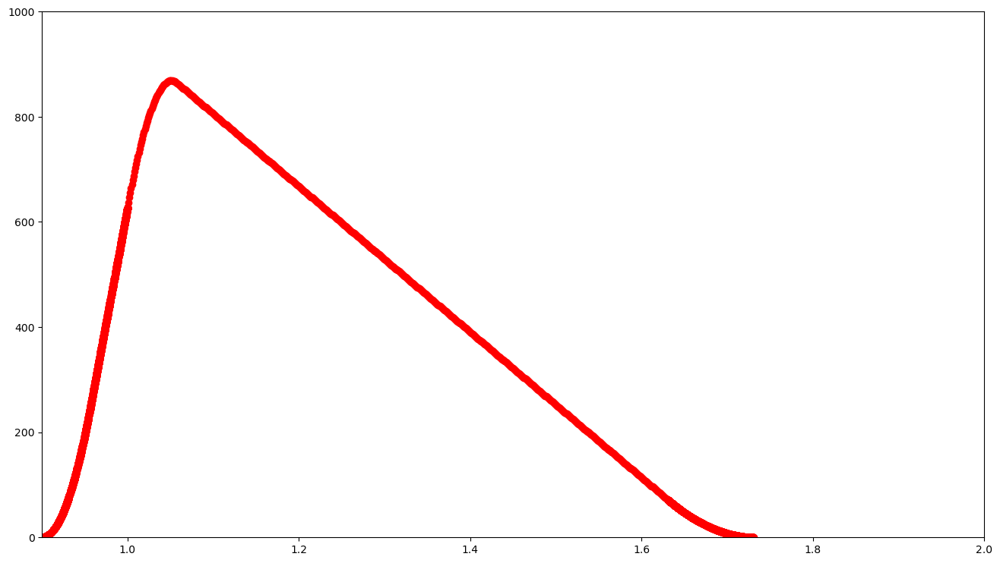

In [18]:
plt.figure(figsize=(16, 9))
plt.scatter(x,y,color='red')
plt.ylim(0,1000)
plt.xlim(0.9,2)
plt.show()

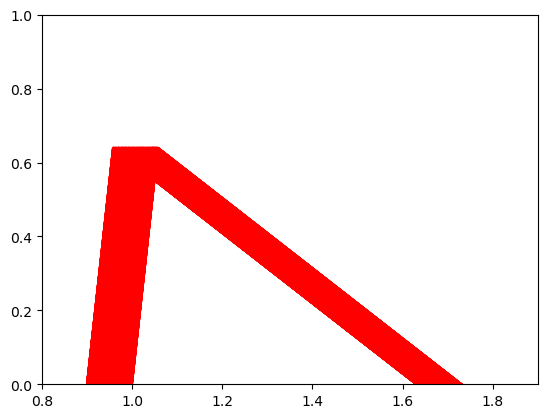

In [19]:


x_values = [float(z) * 1e-8 for z in objectdict["ZK$"].toggle.keys()]

fig, ax = plt.subplots()

for value in objectdict["ZK$"].toggle:
    if objectdict["ZK$"].toggle[value] == "1":
        x = float(value) * 0.00000001
        ax.plot([x, distancedict["XNOR2xp5_ASAP7_75t_L"][1] + x, distancedict["XNOR2xp5_ASAP7_75t_L"][1] + distancedict["XNOR2xp5_ASAP7_75t_L"][0] + x], [0, ogdict["XNOR2xp5_ASAP7_75t_L"], 0], color='red')


plt.ylim(0,1)
plt.xlim(0.8,1.9)
plt.show()


In [20]:
print(outputlist)

[<__main__.OutputPair object at 0x7fad581f8730>, <__main__.OutputPair object at 0x7fad596217c0>, <__main__.OutputPair object at 0x7fad7924ea90>, <__main__.OutputPair object at 0x7fad59660460>, <__main__.OutputPair object at 0x7fad59660490>, <__main__.OutputPair object at 0x7fad59660340>, <__main__.OutputPair object at 0x7facfd22cfa0>, <__main__.OutputPair object at 0x7fad791f3f40>, <__main__.OutputPair object at 0x7fad791f3190>, <__main__.OutputPair object at 0x7fad791f3160>, <__main__.OutputPair object at 0x7fad7a02c190>, <__main__.OutputPair object at 0x7fad7a02c1f0>, <__main__.OutputPair object at 0x7fad7a02c550>, <__main__.OutputPair object at 0x7fad7a02c5e0>, <__main__.OutputPair object at 0x7fad7a02c640>, <__main__.OutputPair object at 0x7fad7a02ccd0>, <__main__.OutputPair object at 0x7fad7a02cd30>, <__main__.OutputPair object at 0x7fad7a02c850>, <__main__.OutputPair object at 0x7fad7a02c7f0>, <__main__.OutputPair object at 0x7fad7a02c790>, <__main__.OutputPair object at 0x7fad7a

In [21]:
print(len(objectdict))

39137


In [22]:
radixtocell={}
for x in objectdict:
    for y in outputlist:
        if objectdict[x].name == y.output:
            radixtocell[x]=y.cellname


In [23]:
print(len(radixtocell))##not all wires are output wires

35338


In [24]:
for x in radixtocell:
    print(x)
    print(radixtocell[x])

K#
DFFLQx4_ASAP7_75t_L
L#
DFFLQx4_ASAP7_75t_L
M#
DFFLQx4_ASAP7_75t_L
N#
DFFLQx4_ASAP7_75t_L
O#
DFFLQx4_ASAP7_75t_L
P#
DFFLQx4_ASAP7_75t_L
Q#
DFFLQx4_ASAP7_75t_L
R#
DFFLQx4_ASAP7_75t_L
S#
DFFLQx4_ASAP7_75t_L
T#
DFFLQx4_ASAP7_75t_L
U#
DFFLQx4_ASAP7_75t_L
V#
DFFLQx4_ASAP7_75t_L
m$
DFFLQx4_ASAP7_75t_L
n$
DFFLQx4_ASAP7_75t_L
o$
DFFLQx4_ASAP7_75t_L
p$
DFFLQx4_ASAP7_75t_L
]%
DFFLQx4_ASAP7_75t_L
^%
DFFLQx4_ASAP7_75t_L
_%
DFFLQx4_ASAP7_75t_L
`%
DFFLQx4_ASAP7_75t_L
m%
DFFLQx4_ASAP7_75t_L
f&
DFFLQx4_ASAP7_75t_L
g&
DFFLQx4_ASAP7_75t_L
h&
DFFLQx4_ASAP7_75t_L
Y'
DFFLQx4_ASAP7_75t_L
Z'
DFFLQx4_ASAP7_75t_L
['
DFFLQx4_ASAP7_75t_L
e'
DFFLQx4_ASAP7_75t_L
o'
DFFLQx4_ASAP7_75t_L
`(
DFFLQx4_ASAP7_75t_L
Q)
DFFLQx4_ASAP7_75t_L
[)
DFFLQx4_ASAP7_75t_L
e)
DFFLQx4_ASAP7_75t_L
V*
DFFLQx4_ASAP7_75t_L
G+
DFFLQx4_ASAP7_75t_L
J+
DFFLQx4_ASAP7_75t_L
w3
DFFLQx4_ASAP7_75t_L
2<
DFFLQx4_ASAP7_75t_L
KD
DFFLQx4_ASAP7_75t_L
dL
DFFLQx4_ASAP7_75t_L
eL
DFFLQx4_ASAP7_75t_L
nL
DFFLQx4_ASAP7_75t_L
oL
DFFLQx4_ASAP7_75t_L
pL
DFFLQx4_

In [25]:
celltoobj={}
for x in distancedict:
    celltoobj[x]=[]
for x in celltoobj:
    for y in objectdict:
        if y in radixtocell and radixtocell[y] == x:
            celltoobj[x].append(objectdict[y])

In [26]:
print(celltoobj)

{'A2O1A1Ixp33_ASAP7_75t_L': [], 'A2O1A1O1Ixp25_ASAP7_75t_L': [<delayobject.DelayObject object at 0x7fad5c745df0>, <delayobject.DelayObject object at 0x7fad697036a0>, <delayobject.DelayObject object at 0x7fad69703880>, <delayobject.DelayObject object at 0x7fad1b8393a0>, <delayobject.DelayObject object at 0x7fad1b839760>, <delayobject.DelayObject object at 0x7fad5f33e0d0>, <delayobject.DelayObject object at 0x7fad085c5130>, <delayobject.DelayObject object at 0x7fad08935fd0>, <delayobject.DelayObject object at 0x7fad0d28d3a0>, <delayobject.DelayObject object at 0x7facf9e72cd0>, <delayobject.DelayObject object at 0x7facf9e83bb0>, <delayobject.DelayObject object at 0x7facda965250>, <delayobject.DelayObject object at 0x7facdb250b50>, <delayobject.DelayObject object at 0x7facdbe6ec10>, <delayobject.DelayObject object at 0x7facdbe6ecd0>, <delayobject.DelayObject object at 0x7facfbe46c10>, <delayobject.DelayObject object at 0x7facfbe46c70>, <delayobject.DelayObject object at 0x7faccb33a5b0>], '

In [27]:
print(celltoobj["AOI31xp67_ASAP7_75t_L"][0].toggle)

{'90000000': '0', '90005055': '1', '90005086': '0', '90015055': '1', '90035052': '0', '90045055': '1', '90045088': '0', '90045126': '1', '90055053': '0', '90055087': '1', '90065052': '0', '90075055': '1', '90085057': '0', '90105083': '1', '90105135': '0', '90115055': '1', '90125052': '0', '90165087': '1', '90165129': '0', '90195055': '1', '90205052': '0', '90215055': '1', '90215129': '0', '90225055': '1', '90235086': '0', '90255055': '1', '90255059': '0', '90265055': '1', '90275053': '0', '90275087': '1', '90275129': '0', '90295055': '1', '90315129': '0', '90355055': '1', '90355129': '0', '90365055': '1', '90375052': '0', '90385055': '1', '90395052': '0', '90405055': '1', '90415052': '0', '90415087': '1', '90425052': '0', '90435087': '1', '90445052': '0', '90445126': '1', '90465129': '0', '90475055': '1', '90495129': '0', '90515126': '1', '90555129': '0', '90565055': '1', '90575053': '0', '90585055': '1', '90585059': '0', '90585083': '1', '90585135': '0', '90595126': '1', '90605053': '

In [28]:
print(len(celltoobj))

200


In [29]:
def g(value, peak, t1, t2, t):
    c = value + t1
    r2 = c + t2
    r1 = value
    m1 = peak / (c - r1)
    m2 = peak / (c - r2)
    
    if t <= c:
        return m1 * (t - r1)
    return m2 * (t - r2)

def plotGraph(distancedict1:str,distancedict2:str,ogdict:float,radix):
    y = []
    peak = ogdict#["AO221x2_ASAP7_75t_L"] peak value
    t1 = distancedict2#["AO221x2_ASAP7_75t_L"][1] 
    t2 = distancedict1#["AO221x2_ASAP7_75t_L"][0]

    timepowerdict = {}
    newdict= {float(key) * 1e-8: value for key, value in objectdict[radix].toggle.items()}
    newdict_keys = list(newdict.keys())
    powerx=[]
    for x in newdict_keys:
        powerx.append(x)
        powerx.append(x+t1+t2)
    additional_points = np.linspace(1, 2, 1000)
    powerx = powerx + additional_points.tolist()  # Convert additional_points to a list before adding
    powerx.sort()
    
    for value in newdict_keys:
        if newdict[value] == "1":
            for t in powerx:
                power = g(value, peak, t1, t2, t)
                if power >= 0:
                    if t not in timepowerdict:
                        timepowerdict[t] = []
                    timepowerdict[t].append(power)
    for x in list(timepowerdict.keys()):
        timepowerdict[x] = sum(timepowerdict[x])
    return timepowerdict

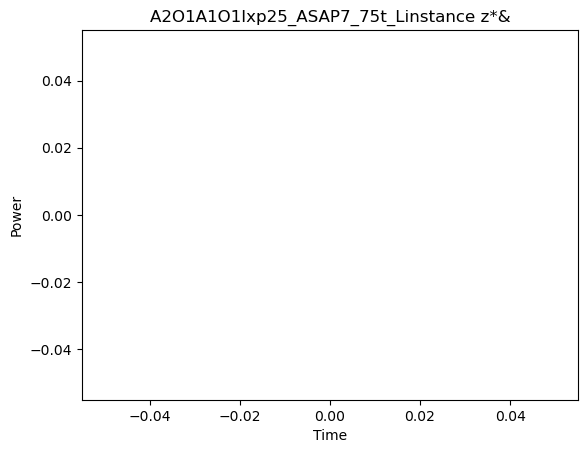

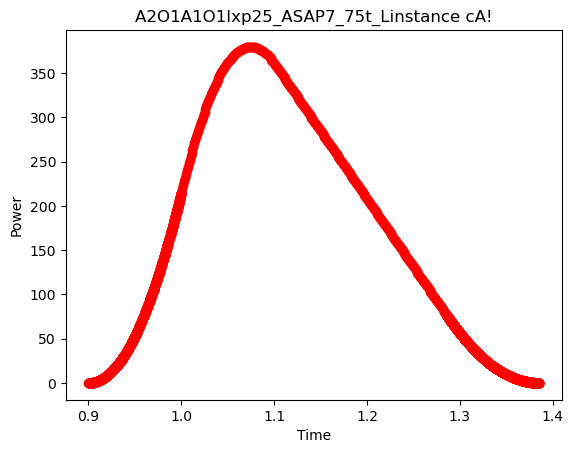

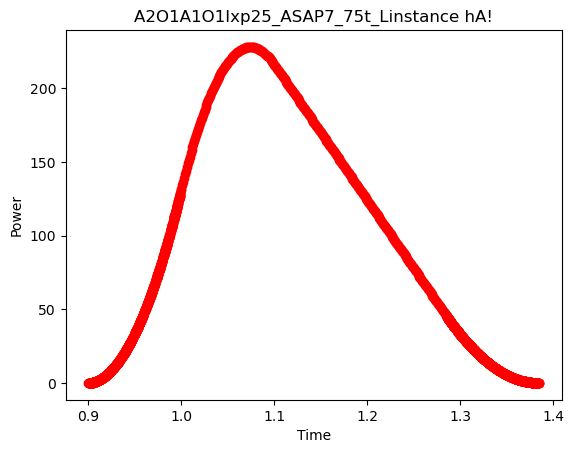

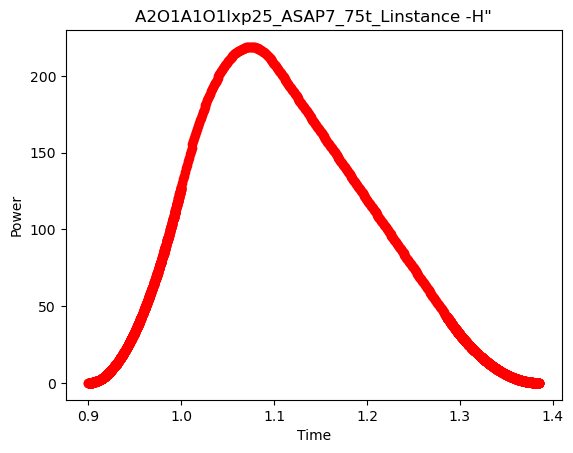

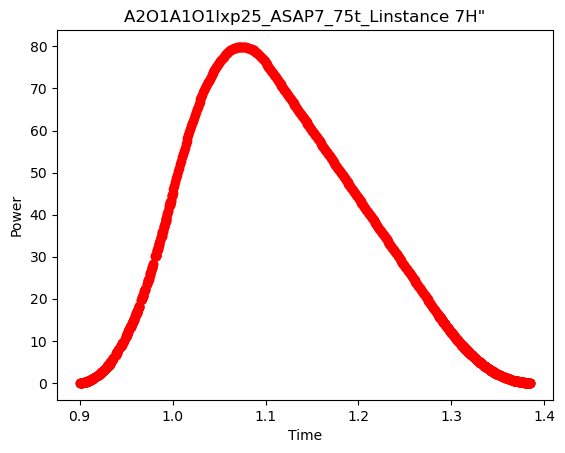

...

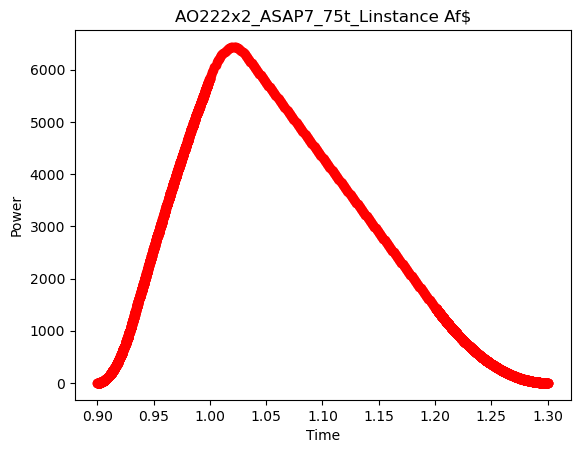

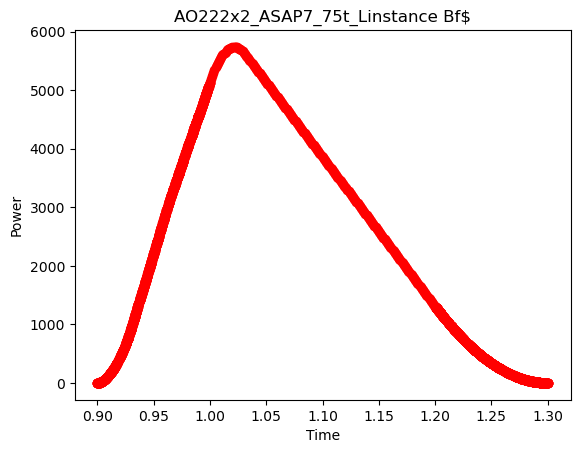

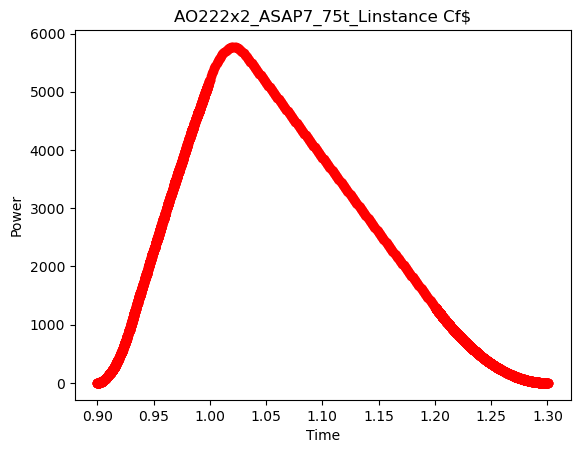

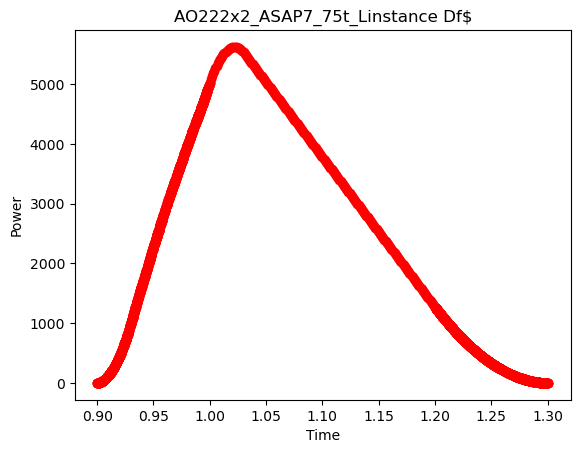

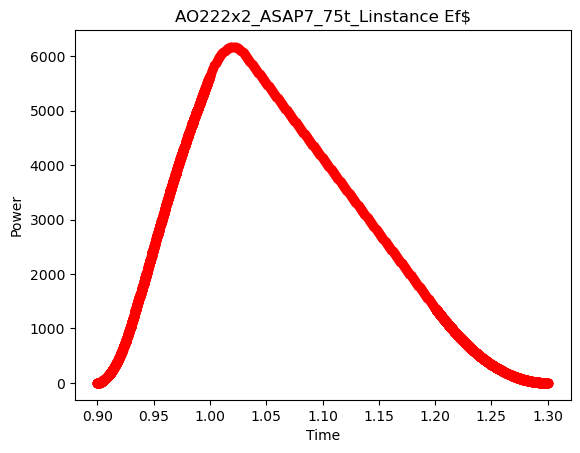

KeyboardInterrupt: 

In [56]:
for x in celltoobj:
    for y in celltoobj[x]:
        dic=plotGraph(distancedict[x][0], distancedict[x][1],ogdict[x],y.radix)
        x_value = list(dic.keys())
        y_value = list(dic.values())
        plt.xlabel("Time")
        plt.ylabel("Power")
        plt.title(x+"instance "+y.radix)
        plt.scatter(x_value, y_value, color = 'red')
        plt.show()

In [30]:
import numpy as np
import pandas as pd

In [31]:
import matplotlib.pyplot as plt

dataset=[]
for x in celltoobj:
    for y in celltoobj[x]:
        dic = plotGraph(distancedict[x][0], distancedict[x][1], ogdict[x], y.radix)
        x_value = list(dic.keys())
        y_value = list(dic.values())
        dataset.append([x_value,y_value])
        #plt.xlabel("Time")
        #plt.ylabel("Power")
        #plt.title(x+" instance "+y.radix) 
        #plt.plot(x_value,y_value,color='red')
        #plt.show()


In [32]:
print(dataset[5][1])

[0.0, 0.0002960595138308782, 0.0005915560642148521, 0.0011870528725580337, 0.0017789348629790574, 0.002668980072742953, 0.0026699578513614684, 0.002673039335492307, 0.0038559736859911323, 0.00680901326224745, 0.0068096058553492825, 0.006817605862226966, 0.00682080586497883, 0.00889011134800921, 0.010958587200694722, 0.013335833689252799, 0.013342233694756525, 0.013352900370595406, 0.015999035979251085, 0.0248897102907049, 0.024897117704482722, 0.03140553811566651, 0.03466480017745423, 0.045318676005028695, 0.045320098228473084, 0.04533743157671235, 0.04534436491600805, 0.05777471634518289, 0.05779255339755953, 0.06222411276366145, 0.062238334998115284, 0.06694589460153745, 0.07642501386342429, 0.0764396212833928, 0.07645725092818069, 0.08177672216888089, 0.08179005551367506, 0.08738197143308848, 0.08738591217721878, 0.0874173196116323, 0.09332784321241029, 0.09955878190351104, 0.09957682636347218, 0.09959638193584709, 0.10606862453814417, 0.11285891185836024, 0.11286163778662867, 0.112

In [33]:
print(len(dataset))

35338


In [34]:
dataset_copy = dataset

In [35]:
print(len(dataset_copy))

35338


In [36]:
print(dataset[1][1])

[0.0, 0.00029567432831452314, 0.0005920301386963168, 0.0023693946299543694, 0.0023718835209833766, 0.0023752613016657896, 0.003263706510054741, 0.0032718842948633036, 0.004444981599867123, 0.004448685306754391, 0.004449722344683418, 0.004461100132244503, 0.006215234973898265, 0.006220005348371461, 0.010363801504074396, 0.010370912621299003, 0.01037754966404215, 0.010380749666795, 0.013038085285081207, 0.01304875196092075, 0.015996310050979373, 0.022507989724226844, 0.03228577590958999, 0.03584133452244932, 0.0393968931353126, 0.04324528162959568, 0.05480431379103634, 0.05895039143018017, 0.06311472093687423, 0.0631213876092723, 0.06313027650580472, 0.06316061727263425, 0.06784826574782962, 0.07287422562503715, 0.0779117706973883, 0.08324084194634411, 0.08865471326821639, 0.0886620317930271, 0.09423987362626267, 0.09424698474348465, 0.10012787868915793, 0.10634575070235984, 0.11257233383416558, 0.11908499128602927, 0.11910715426805223, 0.1259042564089469, 0.12591924901443086, 0.14013721

In [37]:
dataset_copy=dataset

In [40]:
dataset_copy.pop(0)

[[], []]

In [41]:
print(len(dataset_copy))
print(len(dataset))

35337
35337


In [44]:
data= []
for x in dataset:
    if len(x[0]) == 0:
        continue
    data.append(x)

In [45]:
len(data)

34489

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

In [ ]:
X = dataset.iloc[:, 1:-1].values
y = dataset.iloc[:, -1].values